# Data load

In [ ]:
# 1. 구글 드라이브 연결
from google.colab import drive
drive.mount('/content/drive')

# 작업 폴더 생성 및 이동 (원하는 경로로 수정하세요)
import os
PROJECT_PATH = '/content/drive/MyDrive/PixelNeRF-SSU'
if not os.path.exists(PROJECT_PATH):
    os.makedirs(PROJECT_PATH)

%cd {PROJECT_PATH}

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/tmp/ipython-input-597001774.py", line 11, in <cell line: 0>
    get_ipython().run_line_magic('cd', '{PROJECT_PATH}')
  File "/usr/local/lib/python3.12/dist-packages/IPython/core/interactiveshell.py", line 2418, in run_line_magic
    result = fn(*args, **kwargs)
             ^^^^^^^^^^^^^^^^^^^
  File "<decorator-gen-85>", line 2, in cd
  File "/usr/local/lib/python3.12/dist-packages/IPython/core/magic.py", line 187, in <lambda>
    call = lambda f, *a, **k: f(*a, **k)
                              ^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/IPython/core/magics/osm.py", line 342, in cd
    oldcwd = os.getcwd()
             ^^^^^^^^^^^
OSError: [

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

from google.colab import auth
auth.authenticate_user()

%cd /content/drive/MyDrive/pixelNeRF

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/pixelNeRF


- load data (약 12분 소요)







In [ ]:
import os
import multiprocessing

print(f"CPU 개수 (os): {os.cpu_count()}")
print(f"CPU 개수 (multiprocessing): {multiprocessing.cpu_count()}")

CPU 개수 (os): 12
CPU 개수 (multiprocessing): 12


In [ ]:
# Usage: bash scripts/fetch2local.sh -from <bucket/prefix> [-to <extract_path>]
#       -to : /content/pixNeRF_shapeNet_v2_data [DEFAULT]
!bash fetch2local.sh -from nerf-data-ssu/shapeNetV2_cars

Pixel-NeRF GCS Fetcher (Stable v2)
------------------------------------------
BUCKET   : nerf-data-ssu
PREFIX   : shapeNetV2_cars
SOURCE   : gs://nerf-data-ssu/shapeNetV2_cars
ZIP SAVE : /content/load_data
EXTRACT  : /content/pixNeRF_shapeNet_v2_data
Installing crcmod...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.7/89.7 kB 8.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
Skipping Colab authentication (not detected).
Scanning for ZIP files in gs://nerf-data-ssu/shapeNetV2_cars...
📦 Found 5 ZIP files:
gs://nerf-data-ssu/shapeNetV2_cars/cars_test.zip
gs://nerf-data-ssu/shapeNetV2_cars/cars_train.zip
gs://nerf-data-ssu/shapeNetV2_cars/cars_train_test.zip
gs://nerf-data-ssu/shapeNetV2_cars/cars_train_val.zip
gs://nerf-data-ssu/shapeNetV2_cars/cars_val.zip
------------------------------------------
⬇️  Downloading ZIP files to /content/load_data...
Copying gs://nerf-data-ssu/shapeNetV2_cars/cars_test.zip...
Copying gs://nerf-data-ssu/shapeNetV2_cars/cars_train.zip...
Copyi

# 데이터 분석

datasets initializing...
Loaded 2151 instances for train split

🔍 Multiprocessing Filtering (8 cores)
Angle=[10, 45] | Dist=[1.0, 2.0]
Elevation=[5.0, 75.0] (Filtering out bottom/top views)


Filtering: 100%|███████████████████████████████████████████████| 2151/2151 [00:12<00:00, 173.66it/s]


  Valid pairs: 7,179,254 / Valid Instances: 2151
💾 Saving cache to ./cache_debug/pairs_train_a10-45_d1.0-2.0_el5.0-75.0_n2151.pt...
Dataset loaded. Total samples: 2151

🔍 Visualizing Random Samples...


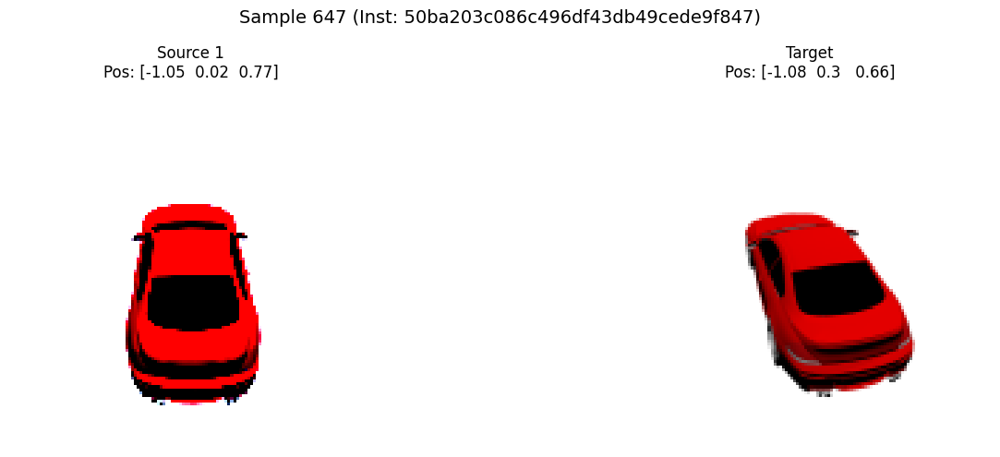

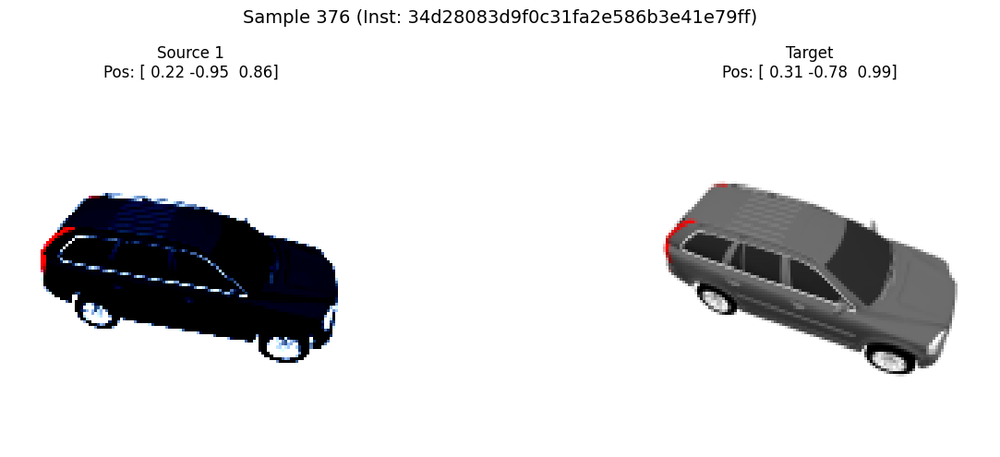

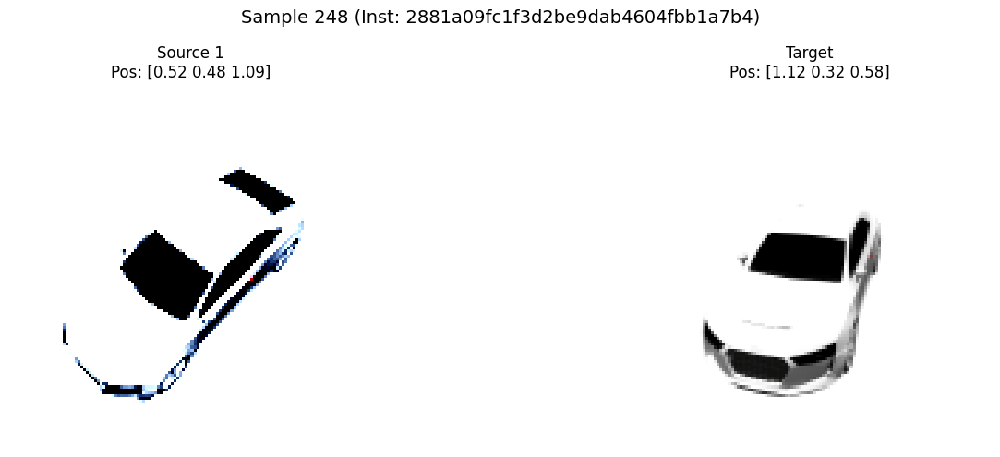

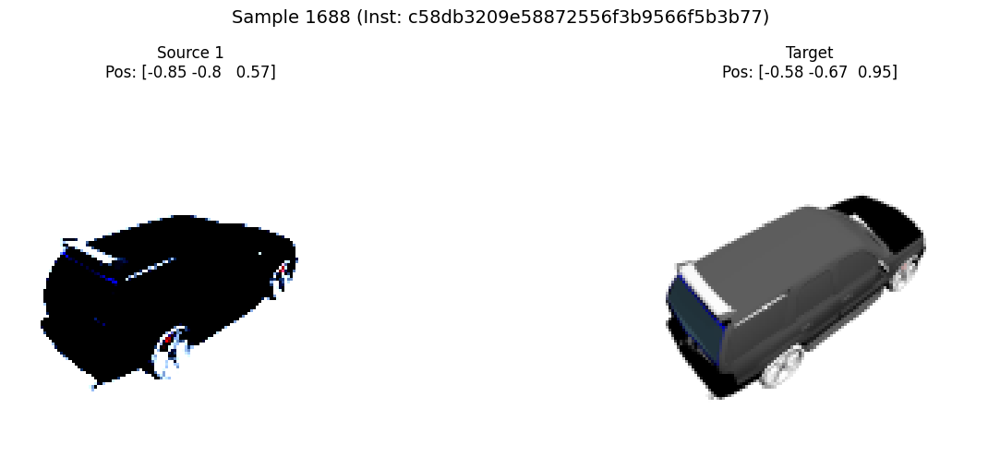

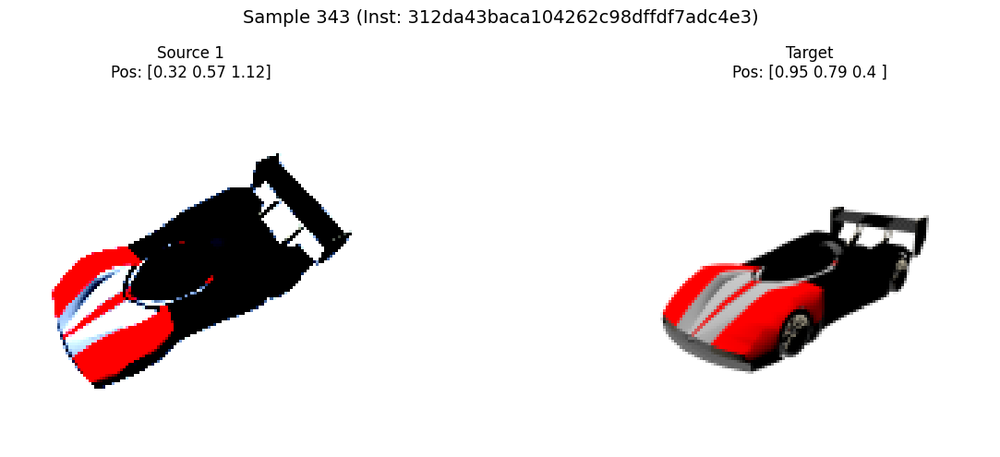


📊 Checking Elevation Distribution of ALL valid pairs...
Checking 1000 random samples for elevation stats...


<function matplotlib.pyplot.title(label: 'str', fontdict: 'dict[str, Any] | None' = None, loc: "Literal['left', 'center', 'right'] | None" = None, pad: 'float | None' = None, *, y: 'float | None' = None, **kwargs) -> 'Text'>

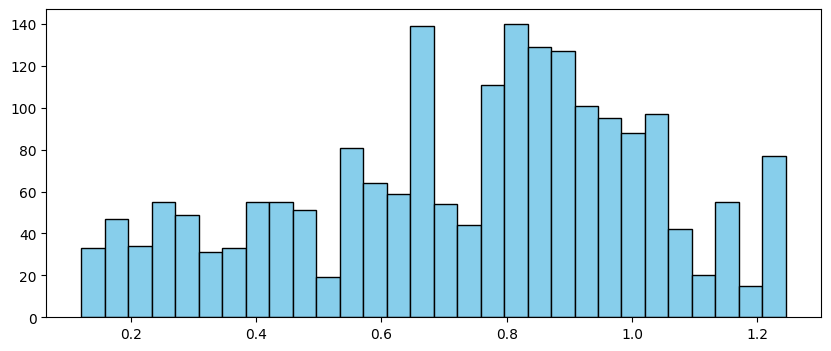

In [ ]:
# test_dataset.ipynb

import os
import torch
import matplotlib.pyplot as plt
import numpy as np
from torch.utils.data import DataLoader
import sys

# 프로젝트 루트 경로를 sys.path에 추가 (필요시 수정)
# 예: 현재 노트북이 프로젝트 루트에 있다면 그대로, 아니라면 경로 추가
sys.path.append(os.getcwd())

# 기존 데이터셋 코드 import
from data.shapenet import FilteredShapeNetDataset, collate_fn

# ==========================================
# 1. 설정 (Config와 비슷하게)
# ==========================================
DATA_ROOT = "/content/pixNeRF_shapeNet_v2_data"  #
CACHE_DIR = "./cache_debug"                # 디버깅용 캐시 폴더 (기존 학습 캐시와 분리)

# 필터링 파라미터 (학습 때 쓸 값과 동일하게 설정)
MIN_ELEVATION = 5.0
MAX_ELEVATION = 75.0
MIN_ANGLE = 10
MAX_ANGLE = 60  # 테스트를 위해 범위를 좀 좁혀봄

# ==========================================
# 2. 데이터셋 초기화
# ==========================================
print("datasets initializing...")

# 기존 캐시가 꼬일 수 있으니 디버그용 캐시 폴더를 비우고 시작하는 게 좋습니다.
import shutil
if os.path.exists(CACHE_DIR):
    shutil.rmtree(CACHE_DIR)

dataset = FilteredShapeNetDataset(
    data_root=DATA_ROOT,
    split='train',
    num_source_views=1,  # 분석용이니 1개면 충분
    image_size=(128, 128),
    z_near=0.8,
    z_far=4.0,
    use_imagenet_normalize=True,
    # 필터링 파라미터도 같이 넣어주세요 (학습 설정과 동일하게)
    min_elevation= MIN_ELEVATION,
    max_elevation= MAX_ELEVATION,
    cache_dir="./cache_debug"
)

print(f"Dataset loaded. Total samples: {len(dataset)}")

# ==========================================
# 3. 시각화 함수 정의
# ==========================================
def denormalize(tensor):
    # use_imagenet_normalize=False로 했으므로 그냥 0~1 클램핑만
    return tensor.permute(1, 2, 0).clamp(0, 1).numpy()

def visualize_sample(sample_idx):
    data = dataset[sample_idx]

    src_images = data['src_images'] # (V, 3, H, W)
    tgt_image = data['tgt_image']   # (3, H, W)

    # Pose 정보 (디버깅용)
    src_poses = data['src_poses']
    tgt_pose = data['tgt_pose']

    # Elevation 계산 함수 (검증용)
    def get_elevation(pose):
        # Shapenet 원본 좌표계 가정 (Z-up이 아닐 수 있으므로 회전된 pose에서 확인)
        # dataset.__getitem__에서 이미 rotation_matrix를 곱해서 나옴
        # 회전된 상태에서는:
        # 4번째 열(위치)의 3번째 값(Z)이 높이 성분

        # 다만, 회전 행렬이 적용되었으므로 Z축이 높이(Height)라고 가정하고 계산
        # center = pose[:3, 3]
        # dist = torch.norm(center)
        # sin_elev = center[2] / dist
        # elev = torch.asin(sin_elev) * 180 / np.pi

        # 간단히 Z좌표만 찍어봐도 바닥인지 알 수 있음
        return pose[:3, 3]

    num_views = src_images.shape[0]
    fig, axes = plt.subplots(1, num_views + 1, figsize=(15, 5))

    # Source Views
    for i in range(num_views):
        ax = axes[i]
        img = denormalize(src_images[i])
        pos = get_elevation(src_poses[i])

        ax.imshow(img)
        ax.set_title(f"Source {i+1}\nPos: {pos.numpy().round(2)}")
        ax.axis('off')

        # 바닥면(Z < 0 근처)이 나오는지 눈으로 확인

    # Target View
    ax = axes[-1]
    img = denormalize(tgt_image)
    pos = get_elevation(tgt_pose)
    ax.imshow(img)
    ax.set_title(f"Target\nPos: {pos.numpy().round(2)}")
    ax.axis('off')

    plt.suptitle(f"Sample {sample_idx} (Inst: {data['instance_id']})", fontsize=14)
    plt.tight_layout()
    plt.show()

# ==========================================
# 4. 랜덤 샘플 검증
# ==========================================
print("\n🔍 Visualizing Random Samples...")
import random

# 랜덤하게 5개 정도 뽑아서 확인
indices = random.sample(range(len(dataset)), 5)

for idx in indices:
    visualize_sample(idx)

# ==========================================
# 5. [심화] 전체 데이터 통계 확인 (Elevation 분포)
# ==========================================
print("\n📊 Checking Elevation Distribution of ALL valid pairs...")

elevations = []

# 캐시된 유효 쌍들을 순회하며 실제 고도각 계산 (단순화된 검증)
# 주의: 이 부분은 dataset 내부 로직을 흉내내야 하므로
# dataset.valid_pairs (inst_idx, src, tgt) 정보를 이용해
# 실제 포즈 파일 하나하나 열어보긴 힘드니,
# 위에서 로드한 20개 인스턴스에 대해서만 __getitem__을 반복 호출해서 통계 냄

check_count = 1000
print(f"Checking {check_count} random samples for elevation stats...")

z_heights = []

for i in range(check_count):
    idx = random.randint(0, len(dataset)-1)
    data = dataset[idx]

    # Source poses
    for pose in data['src_poses']:
        z_heights.append(pose[2, 3].item()) # Z 좌표 (높이)

    # Target pose
    z_heights.append(data['tgt_pose'][2, 3].item())

z_heights = np.array(z_heights)

plt.figure(figsize=(10, 4))
plt.hist(z_heights, bins=30, color='skyblue', edgecolor='black')
plt.title

In [ ]:
# ===================================================================
# 데이터셋 특성 분석 - Colab Notebook
# ===================================================================

import sys

import torch
import numpy as np
from data.shapenet import ShapeNetDataset
from tqdm import tqdm
import matplotlib.pyplot as plt

# ===================================================================
# 1. Dataset 생성
# ===================================================================
dataset = FilteredShapeNetDataset(  # <--- Change class name
    data_root="/content/pixNeRF_shapeNet_v2_data",
    split='train',
    num_source_views=1,  # Analysis script uses 1 view usually
    image_size=(128, 128),
    z_near=0.8,
    z_far=4.0,
    use_imagenet_normalize=True,
    # Add filtering parameters if you want to test them
    min_elevation=5.0,
    max_elevation=85.0,
    cache_dir="./cache_debug"
)

print(f"Total samples: {len(dataset)}")

# ===================================================================
# 2. 통계 수집
# ===================================================================
distances = []
angles = []
pose_samples = []

num_samples = min(500, len(dataset))  # 500개 샘플 분석

print(f"\nAnalyzing {num_samples} samples...")

for i in tqdm(range(num_samples)):
    try:
        data = dataset[i]

        # Poses
        src_pose = data['src_poses'][0]  # (4, 4)
        tgt_pose = data['tgt_pose']      # (4, 4)

        # Method 1: w2c interpretation (현재 코드)
        src_R = src_pose[:3, :3]
        src_t = src_pose[:3, 3]
        src_center_w2c = -torch.matmul(src_R.T, src_t)

        tgt_R = tgt_pose[:3, :3]
        tgt_t = tgt_pose[:3, 3]
        tgt_center_w2c = -torch.matmul(tgt_R.T, tgt_t)

        # Method 2: c2w interpretation
        src_center_c2w = src_pose[:3, 3]
        tgt_center_c2w = tgt_pose[:3, 3]

        # Distance (w2c)
        distance_w2c = torch.norm(src_center_w2c - tgt_center_w2c).item()

        # Distance (c2w)
        distance_c2w = torch.norm(src_center_c2w - tgt_center_c2w).item()

        # Angle between view directions
        src_view_dir = src_R[2, :]  # -Z axis
        tgt_view_dir = tgt_R[2, :]

        cos_angle = torch.dot(src_view_dir, tgt_view_dir).item()
        cos_angle = np.clip(cos_angle, -1.0, 1.0)
        angle = np.arccos(cos_angle) * 180 / np.pi

        distances.append({
            'w2c': distance_w2c,
            'c2w': distance_c2w
        })
        angles.append(angle)

        # 처음 10개 샘플 저장
        if i < 10:
            pose_samples.append({
                'idx': i,
                'src_pose': src_pose,
                'tgt_pose': tgt_pose,
                'src_center_w2c': src_center_w2c,
                'tgt_center_w2c': tgt_center_w2c,
                'src_center_c2w': src_center_c2w,
                'tgt_center_c2w': tgt_center_c2w,
                'distance_w2c': distance_w2c,
                'distance_c2w': distance_c2w,
                'angle': angle
            })

    except Exception as e:
        print(f"Error at sample {i}: {e}")
        continue

# ===================================================================
# 3. 통계 출력
# ===================================================================
print("\n" + "="*70)
print("📊 DATASET STATISTICS")
print("="*70)

# Distance statistics
dist_w2c = [d['w2c'] for d in distances]
dist_c2w = [d['c2w'] for d in distances]

print("\n1️⃣ Camera Distance (w2c interpretation):")
print(f"   Min:    {min(dist_w2c):.6f}")
print(f"   Max:    {max(dist_w2c):.6f}")
print(f"   Mean:   {np.mean(dist_w2c):.6f}")
print(f"   Median: {np.median(dist_w2c):.6f}")
print(f"   Std:    {np.std(dist_w2c):.6f}")

print("\n2️⃣ Camera Distance (c2w interpretation):")
print(f"   Min:    {min(dist_c2w):.6f}")
print(f"   Max:    {max(dist_c2w):.6f}")
print(f"   Mean:   {np.mean(dist_c2w):.6f}")
print(f"   Median: {np.median(dist_c2w):.6f}")
print(f"   Std:    {np.std(dist_c2w):.6f}")

print("\n3️⃣ View Angle:")
print(f"   Min:    {min(angles):.2f}°")
print(f"   Max:    {max(angles):.2f}°")
print(f"   Mean:   {np.mean(angles):.2f}°")
print(f"   Median: {np.median(angles):.2f}°")
print(f"   Std:    {np.std(angles):.2f}°")

# ===================================================================
# 4. 분포 확인
# ===================================================================
print("\n4️⃣ Distribution Analysis:")

# w2c distance bins
bins_w2c = [0, 0.001, 0.01, 0.05, 0.1, 0.5, 1.0, 2.0, 5.0, float('inf')]
hist_w2c, _ = np.histogram(dist_w2c, bins=bins_w2c)

print("\n   w2c Distance Distribution:")
for i in range(len(bins_w2c)-1):
    count = hist_w2c[i]
    pct = count / len(dist_w2c) * 100
    print(f"   [{bins_w2c[i]:.3f}, {bins_w2c[i+1]:.3f}): {count:>5} ({pct:>5.1f}%)")

# c2w distance bins
hist_c2w, _ = np.histogram(dist_c2w, bins=bins_w2c)

print("\n   c2w Distance Distribution:")
for i in range(len(bins_w2c)-1):
    count = hist_c2w[i]
    pct = count / len(dist_c2w) * 100
    print(f"   [{bins_w2c[i]:.3f}, {bins_w2c[i+1]:.3f}): {count:>5} ({pct:>5.1f}%)")

# Angle bins
angle_bins = [0, 30, 60, 90, 120, 150, 180]
hist_angle, _ = np.histogram(angles, bins=angle_bins)

print("\n   View Angle Distribution:")
for i in range(len(angle_bins)-1):
    count = hist_angle[i]
    pct = count / len(angles) * 100
    print(f"   [{angle_bins[i]:>3}°, {angle_bins[i+1]:>3}°): {count:>5} ({pct:>5.1f}%)")

# ===================================================================
# 5. 샘플 케이스 상세 출력
# ===================================================================
print("\n" + "="*70)
print("🔍 Sample Cases (First 10)")
print("="*70)

for sample in pose_samples:
    print(f"\n[Sample {sample['idx']}]")
    print(f"  Camera centers (w2c): {sample['src_center_w2c']} → {sample['tgt_center_w2c']}")
    print(f"  Camera centers (c2w): {sample['src_center_c2w']} → {sample['tgt_center_c2w']}")
    print(f"  Distance (w2c): {sample['distance_w2c']:.6f}")
    print(f"  Distance (c2w): {sample['distance_c2w']:.6f}")
    print(f"  View angle: {sample['angle']:.2f}°")

# ===================================================================
# 6. Visualization
# ===================================================================
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Distance histogram (w2c)
axes[0, 0].hist(dist_w2c, bins=50, edgecolor='black')
axes[0, 0].set_xlabel('Camera Distance (w2c)')
axes[0, 0].set_ylabel('Count')
axes[0, 0].set_title('Distance Distribution (w2c interpretation)')
axes[0, 0].axvline(0.05, color='r', linestyle='--', label='Current threshold (0.05)')
axes[0, 0].legend()

# Distance histogram (c2w)
axes[0, 1].hist(dist_c2w, bins=50, edgecolor='black')
axes[0, 1].set_xlabel('Camera Distance (c2w)')
axes[0, 1].set_ylabel('Count')
axes[0, 1].set_title('Distance Distribution (c2w interpretation)')
axes[0, 1].axvline(0.05, color='r', linestyle='--', label='Current threshold (0.05)')
axes[0, 1].legend()

# Angle histogram
axes[1, 0].hist(angles, bins=30, edgecolor='black')
axes[1, 0].set_xlabel('View Angle (degrees)')
axes[1, 0].set_ylabel('Count')
axes[1, 0].set_title('View Angle Distribution')
axes[1, 0].axvline(120, color='r', linestyle='--', label='Current threshold (120°)')
axes[1, 0].legend()

# Scatter: Distance vs Angle
axes[1, 1].scatter(angles, dist_w2c, alpha=0.5, s=10)
axes[1, 1].set_xlabel('View Angle (degrees)')
axes[1, 1].set_ylabel('Camera Distance (w2c)')
axes[1, 1].set_title('Distance vs Angle')
axes[1, 1].axhline(0.05, color='r', linestyle='--', alpha=0.5)
axes[1, 1].axvline(120, color='r', linestyle='--', alpha=0.5)

plt.tight_layout()
plt.savefig('/content/dataset_analysis.png', dpi=150)
print("\n📊 Visualization saved: /content/dataset_analysis.png")
plt.show()

# ===================================================================
# 7. 권장 파라미터
# ===================================================================
print("\n" + "="*70)
print("💡 RECOMMENDED PARAMETERS")
print("="*70)

# w2c 기준
p5_w2c = np.percentile(dist_w2c, 5)
p1_w2c = np.percentile(dist_w2c, 1)

# c2w 기준
p5_c2w = np.percentile(dist_c2w, 5)
p1_c2w = np.percentile(dist_c2w, 1)

# Angle
p95_angle = np.percentile(angles, 95)

print(f"\n1️⃣ If using w2c interpretation:")
print(f"   min_camera_distance: {p1_w2c:.6f}  (excludes bottom 1%)")
print(f"   max_camera_distance: {max(dist_w2c):.2f}  (no upper limit needed)")

print(f"\n2️⃣ If using c2w interpretation:")
print(f"   min_camera_distance: {p1_c2w:.6f}  (excludes bottom 1%)")
print(f"   max_camera_distance: {max(dist_c2w):.2f}  (no upper limit needed)")

print(f"\n3️⃣ View angle:")
print(f"   max_view_angle: {p95_angle:.1f}°  (excludes top 5%)")

print("\n" + "="*70)

Loaded 2151 instances for train split

🔍 Multiprocessing Filtering (8 cores)
Angle=[10, 45] | Dist=[1.0, 2.0]
Elevation=[5.0, 85.0] (Filtering out bottom/top views)


Filtering:   0%|                                                           | 0/2151 [00:42<?, ?it/s]


KeyboardInterrupt: 

Analyzing instance: 100715345ee54d7ae38b52b4ee9d36a3

RAW FILE CONTENT CHECK

Reading: /content/pixNeRF_shapeNet_v2_data/cars_train/100715345ee54d7ae38b52b4ee9d36a3/pose/000000.txt

--- RAW CONTENT ---
Line 0: '-0.5042614340782166 -0.37587812542915344 0.7774547934532166 -1.0106911659240723 -0.8635510206222534 0.21949009597301483 -0.4539864957332611 0.5901824235916138 -5.960464477539063e-08 -0.9002998471260071 -0.43527036905288696 0.5658514499664307 0.0 0.0 -0.0 1.0'

Total lines: 1

READING MULTIPLE POSES

Parsing /content/pixNeRF_shapeNet_v2_data/cars_train/100715345ee54d7ae38b52b4ee9d36a3/pose/000000.txt:
  Non-empty lines: 1
  Format: Single line with 16 values (reshaped to 4×4)

000000.txt:
[[-5.0426143e-01 -3.7587813e-01  7.7745479e-01 -1.0106912e+00]
 [-8.6355102e-01  2.1949010e-01 -4.5398650e-01  5.9018242e-01]
 [-5.9604645e-08 -9.0029985e-01 -4.3527037e-01  5.6585145e-01]
 [ 0.0000000e+00  0.0000000e+00 -0.0000000e+00  1.0000000e+00]]
  Shape: (4, 4)
  Det(R): 1.000000
  Last r

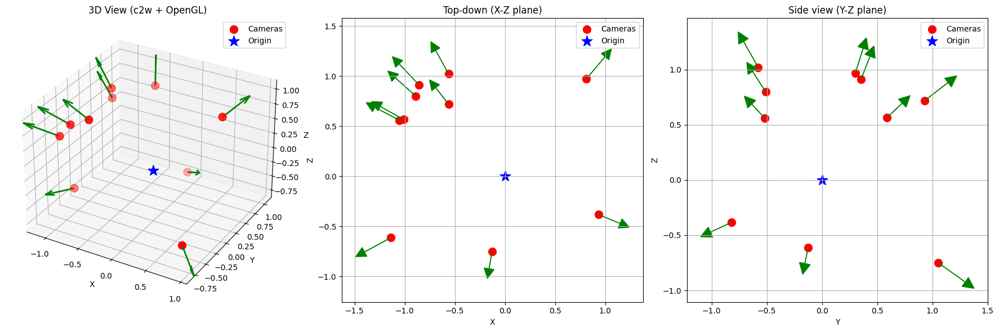


📋 FINAL CONCLUSION

1. POSE FORMAT:
   ✅ c2w (camera-to-world)
   → Translation = camera center in world space

2. COORDINATE SYSTEM:
   ✅ Right-handed (det(R) = +1)

3. CAMERA CONVENTION:
   ✅ OpenCV (+Z forward, Y down)

4. VERIFICATION:
   → Check 'pose_analysis.png'
   → Cameras should form a sphere around origin
   → Green arrows should point toward origin (blue star)



In [ ]:
# ============================================================================
# ShapeNet Pose Format Verification (FIXED)
# ============================================================================

import numpy as np
import torch
import os
from pathlib import Path
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ============================================================================
# 1. Path 설정
# ============================================================================

DATA_ROOT = "/content/pixNeRF_shapeNet_v2_data"
SPLIT = "cars_train"

split_path = os.path.join(DATA_ROOT, SPLIT)
instance_ids = sorted([d for d in os.listdir(split_path)
                      if os.path.isdir(os.path.join(split_path, d))])

INSTANCE_ID = instance_ids[0]
print(f"Analyzing instance: {INSTANCE_ID}")

instance_dir = os.path.join(DATA_ROOT, SPLIT, INSTANCE_ID)
pose_dir = os.path.join(instance_dir, 'pose')

# ============================================================================
# 2. 먼저 RAW 파일 내용 확인
# ============================================================================

print("\n" + "="*80)
print("RAW FILE CONTENT CHECK")
print("="*80)

pose_file_0 = os.path.join(pose_dir, '000000.txt')
print(f"\nReading: {pose_file_0}")
print("\n--- RAW CONTENT ---")
with open(pose_file_0, 'r') as f:
    raw_lines = f.readlines()
    for i, line in enumerate(raw_lines):
        print(f"Line {i}: '{line.strip()}'")

print(f"\nTotal lines: {len(raw_lines)}")

# ============================================================================
# 3. Pose 파일 읽기 함수 (다양한 형식 지원)
# ============================================================================

def read_pose_file_flexible(pose_path):
    """Read pose file - supports multiple formats"""
    with open(pose_path, 'r') as f:
        lines = f.readlines()

    # Remove empty lines
    lines = [l.strip() for l in lines if l.strip()]

    print(f"\nParsing {pose_path}:")
    print(f"  Non-empty lines: {len(lines)}")

    # Try format 1: 4 lines, each with 4 values
    if len(lines) >= 4:
        try:
            pose = []
            for i in range(4):
                values = [float(x) for x in lines[i].split()]
                if len(values) == 4:
                    pose.append(values)

            if len(pose) == 4:
                print(f"  Format: 4 lines × 4 values")
                return np.array(pose, dtype=np.float32)
        except:
            pass

    # Try format 2: Single line with 16 values
    if len(lines) >= 1:
        try:
            values = []
            for line in lines:
                values.extend([float(x) for x in line.split()])

            if len(values) == 16:
                pose = np.array(values, dtype=np.float32).reshape(4, 4)
                print(f"  Format: Single line with 16 values (reshaped to 4×4)")
                return pose
        except:
            pass

    # Try format 3: Multiple lines, concatenate all
    try:
        all_values = []
        for line in lines:
            all_values.extend([float(x) for x in line.split()])

        if len(all_values) == 16:
            pose = np.array(all_values, dtype=np.float32).reshape(4, 4)
            print(f"  Format: {len(lines)} lines with total 16 values")
            return pose
    except:
        pass

    raise ValueError(f"Cannot parse pose file: {pose_path}")

# ============================================================================
# 4. 여러 Pose 읽기
# ============================================================================

print("\n" + "="*80)
print("READING MULTIPLE POSES")
print("="*80)

pose_files = sorted([f for f in os.listdir(pose_dir) if f.endswith('.txt')])[:5]
poses = []

for pose_file in pose_files:
    pose_path = os.path.join(pose_dir, pose_file)
    pose = read_pose_file_flexible(pose_path)
    poses.append(pose)

    print(f"\n{pose_file}:")
    print(pose)
    print(f"  Shape: {pose.shape}")
    print(f"  Det(R): {np.linalg.det(pose[:3, :3]):.6f}")
    print(f"  Last row: {pose[3, :]}")

poses = np.array(poses)

# ============================================================================
# 5. Convention 검증: c2w vs w2c
# ============================================================================

print("\n" + "="*80)
print("CONVENTION CHECK: c2w vs w2c")
print("="*80)

pose_0 = poses[0]
pose_1 = poses[1]

R_0 = pose_0[:3, :3]
t_0 = pose_0[:3, 3]
R_1 = pose_1[:3, :3]
t_1 = pose_1[:3, 3]

print("\n--- Test 1: c2w (camera-to-world) assumption ---")
camera_center_0_c2w = t_0
camera_center_1_c2w = t_1

print(f"Camera 0 center: {camera_center_0_c2w}")
print(f"Camera 1 center: {camera_center_1_c2w}")
print(f"Distance: {np.linalg.norm(camera_center_1_c2w - camera_center_0_c2w):.3f}")

# Verify: c2w @ [0,0,0,1] should equal t
origin_cam = np.array([0, 0, 0, 1])
origin_world = pose_0 @ origin_cam
print(f"\nc2w @ [0,0,0,1] = {origin_world[:3]}")
print(f"t_0 = {t_0}")
print(f"Match? {np.allclose(origin_world[:3], t_0)}")

print("\n--- Test 2: w2c (world-to-camera) assumption ---")
camera_center_0_w2c = -R_0.T @ t_0
camera_center_1_w2c = -R_1.T @ t_1

print(f"Camera 0 center: {camera_center_0_w2c}")
print(f"Camera 1 center: {camera_center_1_w2c}")
print(f"Distance: {np.linalg.norm(camera_center_1_w2c - camera_center_0_w2c):.3f}")

# Verify: w2c @ camera_center = [0,0,0]
test_point = np.array([*camera_center_0_w2c, 1])
test_result = pose_0 @ test_point
print(f"\nw2c @ camera_center = {test_result[:3]}")
print(f"Should be [0,0,0]: {np.allclose(test_result[:3], [0, 0, 0])}")

# ============================================================================
# 6. Rotation Matrix 검증
# ============================================================================

print("\n" + "="*80)
print("ROTATION MATRIX PROPERTIES")
print("="*80)

print(f"\nR_0:\n{R_0}")
print(f"\nOrthogonality check:")
print(f"  R @ R^T =\n{R_0 @ R_0.T}")
print(f"  Is identity? {np.allclose(R_0 @ R_0.T, np.eye(3))}")

print(f"\n  R^T @ R =\n{R_0.T @ R_0}")
print(f"  Is identity? {np.allclose(R_0.T @ R_0, np.eye(3))}")

det = np.linalg.det(R_0)
print(f"\nDeterminant: {det:.6f}")
if abs(det - 1.0) < 0.01:
    print("  → Right-handed (+1)")
elif abs(det + 1.0) < 0.01:
    print("  → Left-handed (-1)")
else:
    print("  ⚠️  Warning: Not a proper rotation!")

# ============================================================================
# 7. Camera Convention Check
# ============================================================================

print("\n" + "="*80)
print("CAMERA CONVENTION: OpenGL vs OpenCV")
print("="*80)

# Column vectors of R (if c2w)
x_axis = R_0[:, 0]
y_axis = R_0[:, 1]
z_axis = R_0[:, 2]

print(f"\nCamera axes (columns of R if c2w):")
print(f"  X-axis: {x_axis}")
print(f"  Y-axis: {y_axis}")
print(f"  Z-axis: {z_axis}")

# Cross product check
cross_xy = np.cross(x_axis, y_axis)
print(f"\nX × Y = {cross_xy}")
print(f"Z-axis = {z_axis}")
print(f"X × Y ≈ Z? {np.allclose(cross_xy, z_axis, atol=0.01)}")

# View direction
print(f"\n--- View Direction ---")
print(f"OpenGL (looks at -Z): R @ [0,0,-1] = -R[:, 2] = {-z_axis}")
print(f"OpenCV (looks at +Z): R @ [0,0,+1] = R[:, 2] = {z_axis}")

# ============================================================================
# 8. Multiple Camera Analysis
# ============================================================================

print("\n" + "="*80)
print("ANALYZING ALL CAMERAS")
print("="*80)

# Read more poses
all_poses = []
for pose_file in sorted(os.listdir(pose_dir))[:20]:
    if pose_file.endswith('.txt'):
        pose_path = os.path.join(pose_dir, pose_file)
        pose = read_pose_file_flexible(pose_path)
        all_poses.append(pose)

all_poses = np.array(all_poses)
print(f"Loaded {len(all_poses)} poses")

# Camera centers (c2w assumption)
centers_c2w = all_poses[:, :3, 3]
print(f"\n--- Assuming c2w ---")
print(f"Camera centers range:")
print(f"  X: [{centers_c2w[:, 0].min():.3f}, {centers_c2w[:, 0].max():.3f}]")
print(f"  Y: [{centers_c2w[:, 1].min():.3f}, {centers_c2w[:, 1].max():.3f}]")
print(f"  Z: [{centers_c2w[:, 2].min():.3f}, {centers_c2w[:, 2].max():.3f}]")
print(f"Mean: {centers_c2w.mean(axis=0)}")

distances_c2w = np.linalg.norm(centers_c2w, axis=1)
print(f"Distances from origin: mean={distances_c2w.mean():.3f}, std={distances_c2w.std():.3f}")

# Camera centers (w2c assumption)
centers_w2c = np.array([-R.T @ t for R, t in
                        zip(all_poses[:, :3, :3], all_poses[:, :3, 3])])
print(f"\n--- Assuming w2c ---")
print(f"Camera centers range:")
print(f"  X: [{centers_w2c[:, 0].min():.3f}, {centers_w2c[:, 0].max():.3f}]")
print(f"  Y: [{centers_w2c[:, 1].min():.3f}, {centers_w2c[:, 1].max():.3f}]")
print(f"  Z: [{centers_w2c[:, 2].min():.3f}, {centers_w2c[:, 2].max():.3f}]")
print(f"Mean: {centers_w2c.mean(axis=0)}")

distances_w2c = np.linalg.norm(centers_w2c, axis=1)
print(f"Distances from origin: mean={distances_w2c.mean():.3f}, std={distances_w2c.std():.3f}")

# Which makes more sense?
print(f"\n--- Comparison ---")
print(f"c2w: cameras at distance {distances_c2w.mean():.3f} ± {distances_c2w.std():.3f}")
print(f"w2c: cameras at distance {distances_w2c.mean():.3f} ± {distances_w2c.std():.3f}")

if distances_c2w.std() < distances_w2c.std() * 0.5:
    print("→ c2w assumption makes more sense (cameras on sphere)")
elif distances_w2c.std() < distances_c2w.std() * 0.5:
    print("→ w2c assumption makes more sense (cameras on sphere)")
else:
    print("→ Unclear, check visualization")

# ============================================================================
# 9. View Directions Analysis
# ============================================================================

print("\n" + "="*80)
print("VIEW DIRECTIONS ANALYSIS")
print("="*80)

# View directions (OpenGL: -Z, OpenCV: +Z)
view_dirs_opengl = np.array([-pose[:3, :3] @ np.array([0, 0, 1])
                              for pose in all_poses])
view_dirs_opencv = np.array([pose[:3, :3] @ np.array([0, 0, 1])
                             for pose in all_poses])

# Check if cameras look toward origin
dot_opengl_c2w = np.array([
    np.dot(vdir, -center) / (np.linalg.norm(center) + 1e-6)
    for vdir, center in zip(view_dirs_opengl, centers_c2w)
])

dot_opencv_c2w = np.array([
    np.dot(vdir, -center) / (np.linalg.norm(center) + 1e-6)
    for vdir, center in zip(view_dirs_opencv, centers_c2w)
])

print(f"Assuming c2w:")
print(f"  OpenGL (-Z): view·(-center) = {dot_opengl_c2w.mean():.3f} ± {dot_opengl_c2w.std():.3f}")
print(f"  OpenCV (+Z): view·(-center) = {dot_opencv_c2w.mean():.3f} ± {dot_opencv_c2w.std():.3f}")
print(f"  → Values close to 1.0 means cameras look at origin")

if dot_opengl_c2w.mean() > 0.5:
    print(f"  → OpenGL convention (cameras look at origin)")
elif dot_opencv_c2w.mean() > 0.5:
    print(f"  → OpenCV convention (cameras look at origin)")

# ============================================================================
# 10. Visualization
# ============================================================================

print("\n" + "="*80)
print("GENERATING VISUALIZATION")
print("="*80)

fig = plt.figure(figsize=(18, 6))

# Use c2w assumption for visualization
centers = centers_c2w[:10]
view_dirs = view_dirs_opengl[:10]

# 3D plot
ax1 = fig.add_subplot(131, projection='3d')
ax1.scatter(centers[:, 0], centers[:, 1], centers[:, 2],
           c='red', s=100, label='Cameras')
ax1.scatter([0], [0], [0], c='blue', s=200, marker='*', label='Origin')

for center, vdir in zip(centers, view_dirs):
    ax1.quiver(center[0], center[1], center[2],
              vdir[0]*0.5, vdir[1]*0.5, vdir[2]*0.5,
              color='green', arrow_length_ratio=0.3, linewidth=2)

ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Z')
ax1.set_title('3D View (c2w + OpenGL)')
ax1.legend()

# Top-down (X-Z)
ax2 = fig.add_subplot(132)
ax2.scatter(centers[:, 0], centers[:, 2], c='red', s=100, label='Cameras')
ax2.scatter([0], [0], c='blue', s=200, marker='*', label='Origin')

for center, vdir in zip(centers, view_dirs):
    ax2.arrow(center[0], center[2], vdir[0]*0.3, vdir[2]*0.3,
             head_width=0.1, head_length=0.1, fc='green', ec='green')

ax2.set_xlabel('X')
ax2.set_ylabel('Z')
ax2.set_title('Top-down (X-Z plane)')
ax2.legend()
ax2.grid(True)
ax2.axis('equal')

# Side view (Y-Z)
ax3 = fig.add_subplot(133)
ax3.scatter(centers[:, 1], centers[:, 2], c='red', s=100, label='Cameras')
ax3.scatter([0], [0], c='blue', s=200, marker='*', label='Origin')

for center, vdir in zip(centers, view_dirs):
    ax3.arrow(center[1], center[2], vdir[1]*0.3, vdir[2]*0.3,
             head_width=0.1, head_length=0.1, fc='green', ec='green')

ax3.set_xlabel('Y')
ax3.set_ylabel('Z')
ax3.set_title('Side view (Y-Z plane)')
ax3.legend()
ax3.grid(True)
ax3.axis('equal')

plt.tight_layout()
plt.savefig('pose_analysis.png', dpi=150, bbox_inches='tight')
print("Saved: pose_analysis.png")
plt.show()

# ============================================================================
# 11. Final Conclusion
# ============================================================================

print("\n" + "="*80)
print("📋 FINAL CONCLUSION")
print("="*80)

print("\n1. POSE FORMAT:")
if np.allclose(pose_0 @ origin_cam, np.array([*t_0, 1])):
    print("   ✅ c2w (camera-to-world)")
    print("   → Translation = camera center in world space")
elif np.allclose(pose_0 @ test_point, np.array([0, 0, 0, 1])):
    print("   ✅ w2c (world-to-camera)")
    print("   → Camera center = -R^T @ t")
else:
    print("   ⚠️  Ambiguous - check visualization")

print("\n2. COORDINATE SYSTEM:")
if abs(det - 1.0) < 0.01:
    print("   ✅ Right-handed (det(R) = +1)")
elif abs(det + 1.0) < 0.01:
    print("   ⚠️  Left-handed (det(R) = -1)")

print("\n3. CAMERA CONVENTION:")
if dot_opengl_c2w.mean() > dot_opencv_c2w.mean():
    print("   ✅ OpenGL (-Z forward, Y up)")
else:
    print("   ✅ OpenCV (+Z forward, Y down)")

print("\n4. VERIFICATION:")
print("   → Check 'pose_analysis.png'")
print("   → Cameras should form a sphere around origin")
print("   → Green arrows should point toward origin (blue star)")

print("\n" + "="*80)

🔄 Analyzing 2000 instances from cars_train...


100%|██████████| 2000/2000 [04:09<00:00,  8.00it/s]



📊 CAMERA DISTANCE STATISTICS (Unit: World Scale)
 • Total Views Analyzed : 500000
 • Minimum Distance     : 1.3000
 • Maximum Distance     : 1.3000
 • Mean Distance        : 1.3000
 • Std Dev              : 0.0000
------------------------------------------------------------
🚀 RECOMMENDED SETTINGS for PixelNeRF:
   z_near : 0.6000  (Safe lower bound)
   z_far  : 2.0000   (Safe upper bound)
------------------------------------------------------------
NOTE: z_near가 너무 작으면(예: 0.01) depth sampling 해상도가 낭비됩니다.
      z_near를 가능한 크게(객체 앞까지), z_far를 가능한 작게 잡으세요.


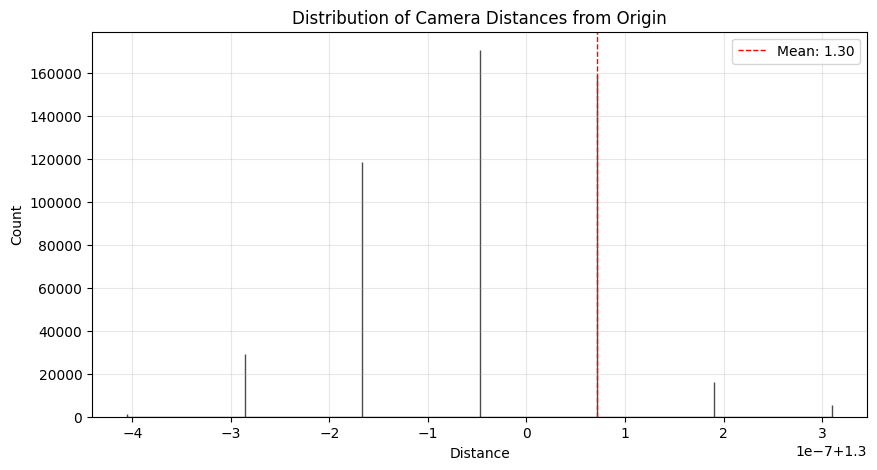

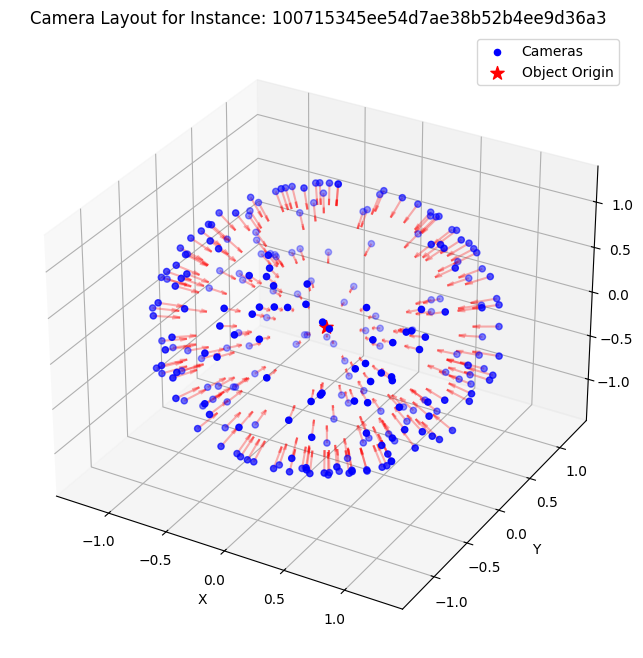

In [ ]:
# ============================================================================
# [Setup] 라이브러리 임포트 및 경로 설정
# ============================================================================
import numpy as np
import os
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from tqdm import tqdm # 진행상황 표시

# ----------------------------------------------------------------------------
# 사용자 경로 설정
# ----------------------------------------------------------------------------
DATA_ROOT = "/content/pixNeRF_shapeNet_v2_data" # 데이터 루트 경로
CATEGORY = "cars_train"                           # 분석할 카테고리 (train 셋 권장)
SAMPLE_NUM_INSTANCES = 2000                     # 분석할 객체(Instance) 수 (너무 많으면 오래 걸림)
ASSUMED_OBJECT_RADIUS = 0.5                       # ShapeNet 객체의 대략적인 반지름 (Unit Cube 안에 있다면 보통 0.5)

base_path = os.path.join(DATA_ROOT, CATEGORY)

# ============================================================================
# [Utils] Pose 읽기 및 거리 계산 함수
# ============================================================================

def read_pose(pose_path):
    """
    16개의 float가 한 줄에 있는 ShapeNet 포맷을 읽어서 4x4 행렬로 반환
    """
    with open(pose_path, 'r') as f:
        content = f.read().strip()
        values = [float(x) for x in content.split()]
        if len(values) != 16:
            return None
        return np.array(values, dtype=np.float32).reshape(4, 4)

def analyze_camera_convention(poses):
    """
    카메라가 c2w인지 w2c인지, OpenCV 좌표계인지 확인
    """
    sample_pose = poses[0]
    R = sample_pose[:3, :3]
    t = sample_pose[:3, 3]

    # 가정 1: C2W (Translation 자체가 카메라 위치)
    cam_pos_c2w = t
    dist_c2w = np.linalg.norm(cam_pos_c2w)

    # 가정 2: W2C (R*P + t = 0 -> P = -R^T * t)
    cam_pos_w2c = -np.matmul(R.T, t)
    dist_w2c = np.linalg.norm(cam_pos_w2c)

    # 보통 ShapeNet 카메라는 1.0 ~ 3.0 정도 거리에 위치함
    # 만약 한쪽 가정이 터무니없이 작거나(0에 근접) 크다면 다른 쪽이 정답

    # View Direction 확인 (OpenCV: +Z axis looks forward? usually yes)
    # C2W 가정 시, Z축 벡터가 원점(0,0,0)을 향하고 있는지 확인
    # Vector from Cam to Origin: -cam_pos
    view_vec_opencv = R[:, 2] # Z axis column
    dot_prod = np.dot(view_vec_opencv, -cam_pos_c2w)

    is_c2w = True
    # 간단한 휴리스틱: C2W일 확률이 높음 (PixelNeRF 데이터셋 특성상)
    # 하지만 확실히 하기 위해 리턴값에 계산 로직을 포함
    return is_c2w

# ============================================================================
# [Main] 데이터 순회 및 거리 측정
# ============================================================================

instance_ids = sorted([d for d in os.listdir(base_path)
                       if os.path.isdir(os.path.join(base_path, d))])[:SAMPLE_NUM_INSTANCES]

all_distances = []
valid_poses_count = 0

print(f"🔄 Analyzing {len(instance_ids)} instances from {CATEGORY}...")

for inst_id in tqdm(instance_ids):
    pose_dir = os.path.join(base_path, inst_id, 'pose')
    if not os.path.exists(pose_dir):
        continue

    pose_files = sorted([f for f in os.listdir(pose_dir) if f.endswith('.txt')])

    for p_file in pose_files:
        pose_mat = read_pose(os.path.join(pose_dir, p_file))
        if pose_mat is None:
            continue

        # -----------------------------------------------------------
        # 좌표계 판별 및 카메라 위치 추출
        # (PixelNeRF ShapeNet 포맷은 대부분 C2W로 저장됨)
        # Pose Matrix의 마지막 열(Translation)이 카메라 위치라고 가정
        # -----------------------------------------------------------

        # C2W Assumption (Standard for NeRF dataloaders)
        cam_pos = pose_mat[:3, 3]

        # 거리 계산 (Euclidean Distance to Origin)
        dist = np.linalg.norm(cam_pos)

        # 이상치 제거 (너무 가깝거나 너무 먼 경우 데이터 오류일 수 있음)
        if 0.1 < dist < 10.0:
            all_distances.append(dist)
            valid_poses_count += 1

all_distances = np.array(all_distances)

# ============================================================================
# [Analysis] 통계 분석 및 결과 시각화
# ============================================================================

if len(all_distances) == 0:
    print("❌ No valid poses found. Check directory path.")
else:
    mean_dist = np.mean(all_distances)
    min_dist = np.min(all_distances)
    max_dist = np.max(all_distances)
    std_dist = np.std(all_distances)

    print("\n" + "="*60)
    print("📊 CAMERA DISTANCE STATISTICS (Unit: World Scale)")
    print("="*60)
    print(f" • Total Views Analyzed : {valid_poses_count}")
    print(f" • Minimum Distance     : {min_dist:.4f}")
    print(f" • Maximum Distance     : {max_dist:.4f}")
    print(f" • Mean Distance        : {mean_dist:.4f}")
    print(f" • Std Dev              : {std_dist:.4f}")
    print("-" * 60)

    # ----------------------------------------------------------------
    # ✨ [핵심] Z_NEAR / Z_FAR 추천 로직
    # ----------------------------------------------------------------
    # 객체는 원점에 있고 반지름(radius)이 ASSUMED_OBJECT_RADIUS 라고 가정.
    # z_near는 (최소 카메라 거리 - 객체 반지름) 보다 작아야 함.
    # z_far는 (최대 카메라 거리 + 객체 반지름) 보다 커야 함.

    # Margin을 조금 두어 안전하게 설정
    margin = 0.2

    rec_z_near = max(0.1, min_dist - ASSUMED_OBJECT_RADIUS - margin)
    rec_z_far = max_dist + ASSUMED_OBJECT_RADIUS + margin

    # PixelNeRF 논문/구현체에서 자주 쓰는 값과 비교
    # 보통 ShapeNet은 Unit Sphere(1.0) 기준, 카메라는 약 1.3~2.5 거리에 위치

    print(f"🚀 RECOMMENDED SETTINGS for PixelNeRF:")
    print(f"   z_near : {rec_z_near:.4f}  (Safe lower bound)")
    print(f"   z_far  : {rec_z_far:.4f}   (Safe upper bound)")
    print("-" * 60)
    print("NOTE: z_near가 너무 작으면(예: 0.01) depth sampling 해상도가 낭비됩니다.")
    print("      z_near를 가능한 크게(객체 앞까지), z_far를 가능한 작게 잡으세요.")
    print("="*60)

    # 히스토그램 그리기
    plt.figure(figsize=(10, 5))
    plt.hist(all_distances, bins=50, color='skyblue', edgecolor='black', alpha=0.7)
    plt.axvline(mean_dist, color='red', linestyle='dashed', linewidth=1, label=f'Mean: {mean_dist:.2f}')
    plt.title('Distribution of Camera Distances from Origin')
    plt.xlabel('Distance')
    plt.ylabel('Count')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

    # 3D 시각화 (첫 번째 인스턴스에 대해서만)
    # 카메라 위치가 구(Sphere) 형태를 이루는지 확인
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, projection='3d')

    # 첫 인스턴스 다시 로드
    inst_id = instance_ids[0]
    pose_dir = os.path.join(base_path, inst_id, 'pose')
    pose_files = sorted([f for f in os.listdir(pose_dir) if f.endswith('.txt')])

    cam_xs, cam_ys, cam_zs = [], [], []
    for p_file in pose_files:
        pose_mat = read_pose(os.path.join(pose_dir, p_file))
        if pose_mat is not None:
            pos = pose_mat[:3, 3] # C2W translation
            cam_xs.append(pos[0])
            cam_ys.append(pos[1])
            cam_zs.append(pos[2])

            # View Direction (Z-axis of rotation matrix)
            # OpenCV convention: Z axis is look-at direction?
            # Let's draw tiny quivers
            vec = pose_mat[:3, 2] # Z-axis column
            # OpenCV의 경우 +Z가 보는 방향
            ax.quiver(pos[0], pos[1], pos[2], vec[0], vec[1], vec[2], length=0.2, color='r', alpha=0.3)

    ax.scatter(cam_xs, cam_ys, cam_zs, s=20, c='blue', label='Cameras')
    ax.scatter([0], [0], [0], s=100, c='red', marker='*', label='Object Origin')

    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title(f'Camera Layout for Instance: {inst_id}')
    ax.legend()
    plt.show()

🎥 Generating Enhanced Animation...


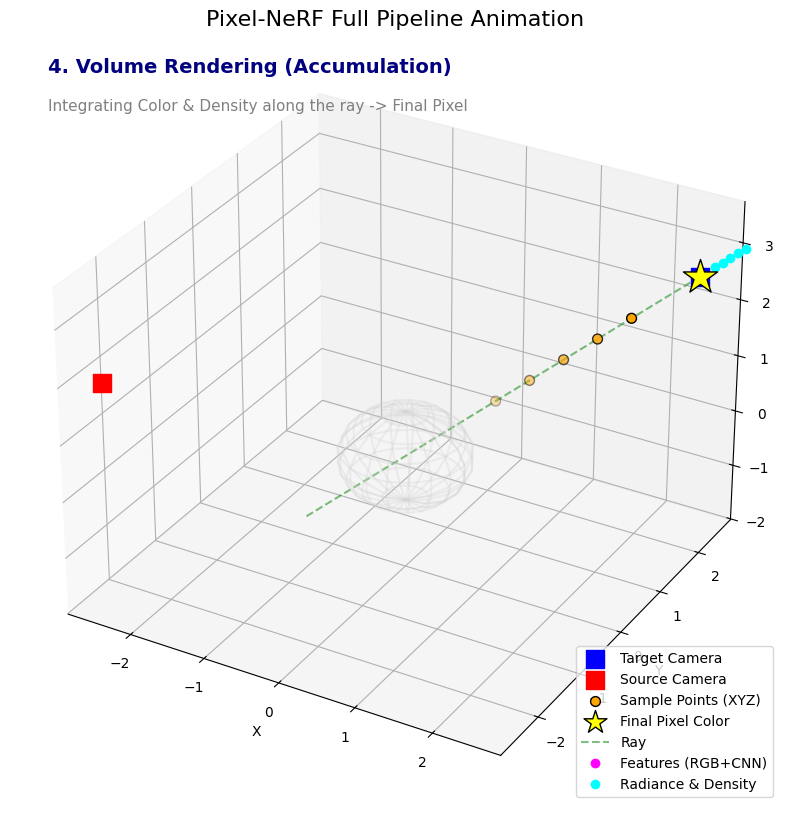

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from mpl_toolkits.mplot3d import Axes3D

# ==========================================
# 1. 설정 및 초기화
# ==========================================
def set_axes_equal(ax):
    """3D 축 비율 고정"""
    x_limits = ax.get_xlim3d()
    y_limits = ax.get_ylim3d()
    z_limits = ax.get_zlim3d()
    x_range = abs(x_limits[1] - x_limits[0])
    x_middle = np.mean(x_limits)
    y_range = abs(y_limits[1] - y_limits[0])
    y_middle = np.mean(y_limits)
    z_range = abs(z_limits[1] - z_limits[0])
    z_middle = np.mean(z_limits)
    plot_radius = 0.5 * max([x_range, y_range, z_range])
    ax.set_xlim3d([x_middle - plot_radius, x_middle + plot_radius])
    ax.set_ylim3d([y_middle - plot_radius, y_middle + plot_radius])
    ax.set_zlim3d([z_middle - plot_radius, z_middle + plot_radius])

fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')
ax.set_title("Pixel-NeRF Full Pipeline Animation", fontsize=16)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

# 카메라 및 객체 위치
target_cam_pos = np.array([2.5, 2.5, 2.5])
source_cam_pos = np.array([-2.5, -2.5, 2.0])
object_center = np.array([0, 0, 0])

# 텍스트 표시
status_text = ax.text2D(0.05, 0.95, "", transform=ax.transAxes, fontsize=14, color='navy', weight='bold')
sub_text = ax.text2D(0.05, 0.90, "", transform=ax.transAxes, fontsize=11, color='gray')

# 객체(물체) - 와이어프레임
u, v = np.mgrid[0:2*np.pi:20j, 0:np.pi:10j]
x = 0.8 * np.cos(u) * np.sin(v)
y = 0.8 * np.sin(u) * np.sin(v)
z = 0.8 * np.cos(v)
ax.plot_wireframe(x, y, z, color="lightgray", alpha=0.3)

# 카메라 그리기
ax.scatter(*target_cam_pos, c='blue', s=150, marker='s', label='Target Camera')
ax.scatter(*source_cam_pos, c='red', s=150, marker='s', label='Source Camera')

# ==========================================
# 2. 동적 요소 정의
# ==========================================
# [중요] Scatter는 에러 방지를 위해 매번 새로 그릴 것이므로,
# 여기서는 범례(Legend)용 '더미(Dummy)'만 생성해둡니다.
ax.scatter([], [], [], c='orange', s=50, edgecolors='black', label='Sample Points (XYZ)')
ax.scatter([], [], [], c='yellow', s=300, marker='*', edgecolors='black', label='Final Pixel Color')

# Line Plot들은 업데이트가 안전하므로 그대로 생성
ray_line, = ax.plot([], [], [], 'g--', linewidth=1.5, alpha=0.5, label='Ray')
proj_lines = [ax.plot([], [], [], 'r:', linewidth=0.8, alpha=0.4)[0] for _ in range(5)]
feat_particles, = ax.plot([], [], [], 'o', c='magenta', markersize=6, label='Features (RGB+CNN)')
render_particles, = ax.plot([], [], [], 'o', c='cyan', markersize=6, label='Radiance & Density')

# 동적 Scatter 객체를 담을 변수 (매 프레임 갱신)
active_scatters = {'samples': None, 'final': None}

# 범례
ax.legend(loc='lower right', fontsize=10)
set_axes_equal(ax)

# ==========================================
# 3. 로직 데이터 계산
# ==========================================
ray_vec = object_center - target_cam_pos
ray_len = np.linalg.norm(ray_vec)
ray_dir = ray_vec / ray_len
ray_end = target_cam_pos + ray_dir * (ray_len + 1.5)
ray_path = np.linspace(target_cam_pos, ray_end, 100)

sample_pts = np.linspace(target_cam_pos + ray_dir*1.0, target_cam_pos + ray_dir*3.0, 5)

def update(frame):
    # [Fix] 이전 프레임의 Scatter 객체가 있다면 삭제 (청소)
    if active_scatters['samples']:
        active_scatters['samples'].remove()
    if active_scatters['final']:
        active_scatters['final'].remove()

    # --- Phase 1: Ray Casting (0~30) ---
    if frame < 30:
        status_text.set_text("1. Ray Casting & Sampling")
        sub_text.set_text("Generating rays from Target Camera into 3D space")

        idx = int((frame / 30) * 100)
        ray_line.set_data(ray_path[:idx, 0], ray_path[:idx, 1])
        ray_line.set_3d_properties(ray_path[:idx, 2])

        # 샘플 포인트 그리기 (Re-plot)
        if frame > 10:
            pts_idx = int((frame - 10) / 20 * 5)
            visible_pts = sample_pts[:pts_idx]
            if len(visible_pts) > 0:
                active_scatters['samples'] = ax.scatter(
                    visible_pts[:, 0], visible_pts[:, 1], visible_pts[:, 2],
                    c='orange', s=50, edgecolors='black'
                )

    # --- Phase 2: Projection & Feature Fetch (30~70) ---
    elif frame < 70:
        status_text.set_text("2. Feature Extraction (Source -> World)")
        sub_text.set_text("Projecting 3D points to Source View & Fetching Features")

        # 전체 샘플 포인트 표시
        active_scatters['samples'] = ax.scatter(
            sample_pts[:, 0], sample_pts[:, 1], sample_pts[:, 2],
            c='orange', s=50, edgecolors='black'
        )

        ray_line.set_data(ray_path[:, 0], ray_path[:, 1])
        ray_line.set_3d_properties(ray_path[:, 2])

        for i, pt in enumerate(sample_pts):
            proj_lines[i].set_data([pt[0], source_cam_pos[0]], [pt[1], source_cam_pos[1]])
            proj_lines[i].set_3d_properties([pt[2], source_cam_pos[2]])

        prog = (frame - 30) / 40
        feat_x, feat_y, feat_z = [], [], []
        for pt in sample_pts:
            curr = source_cam_pos + (pt - source_cam_pos) * prog
            feat_x.append(curr[0])
            feat_y.append(curr[1])
            feat_z.append(curr[2])

        feat_particles.set_data(feat_x, feat_y)
        feat_particles.set_3d_properties(feat_z)

    # --- Phase 3: MLP Processing (70~100) ---
    elif frame < 100:
        status_text.set_text("3. MLP Processing (Input -> RGB/Density)")
        sub_text.set_text("Input: [XYZ + Features] -> MLP -> Output: [Color + Density]")

        feat_particles.set_data([], [])
        feat_particles.set_3d_properties([])

        # 깜빡임 효과 (색상 변경)
        colors = ['orange', 'purple', 'lime']
        c_idx = (frame // 5) % 3
        # 크기 변경 (Re-plot이므로 안전함)
        sizes = [100 if c_idx==1 else 50] * 5

        active_scatters['samples'] = ax.scatter(
            sample_pts[:, 0], sample_pts[:, 1], sample_pts[:, 2],
            c=colors[c_idx], s=sizes, edgecolors='black'
        )

        for line in proj_lines:
            line.set_alpha(0.1)

    # --- Phase 4: Volume Rendering (100~140) ---
    else:
        status_text.set_text("4. Volume Rendering (Accumulation)")
        sub_text.set_text("Integrating Color & Density along the ray -> Final Pixel")

        active_scatters['samples'] = ax.scatter(
            sample_pts[:, 0], sample_pts[:, 1], sample_pts[:, 2],
            c='orange', s=50, edgecolors='black'
        )

        for line in proj_lines:
            line.set_data([], [])
            line.set_3d_properties([])

        prog = (frame - 100) / 40
        rend_x, rend_y, rend_z = [], [], []
        for pt in sample_pts:
            curr = pt + (target_cam_pos - pt) * prog
            rend_x.append(curr[0])
            rend_y.append(curr[1])
            rend_z.append(curr[2])

        render_particles.set_data(rend_x, rend_y)
        render_particles.set_3d_properties(rend_z)

        # 최종 픽셀 등장
        if frame > 130:
            final_size = 100 + (frame-130)*30
            active_scatters['final'] = ax.scatter(
                target_cam_pos[0], target_cam_pos[1], target_cam_pos[2],
                c='yellow', s=final_size, marker='*', edgecolors='black'
            )

    # 반환 값 생성 (None 제외)
    artists = [ray_line, feat_particles, render_particles, status_text, sub_text] + proj_lines
    if active_scatters['samples']: artists.append(active_scatters['samples'])
    if active_scatters['final']: artists.append(active_scatters['final'])

    return artists

# ==========================================
# 4. 애니메이션 생성
# ==========================================
print("🎥 Generating Enhanced Animation...")
ani = animation.FuncAnimation(fig, update, frames=150, interval=50, blit=False)

from IPython.display import HTML
HTML(ani.to_jshtml())

# Pose Test

- 월드좌표계 -> 카메라좌표계 변환 시 축 방향 확인하기
> 알맞은 회전행렬 찾기

Loaded 352 instances for val split

🚀 Loading cached pairs from ./cache/pairs_val_a10-45_d1.0-2.0_n352.pt
  Loaded 6,390,912 pairs from cache.
Dataset loaded using UPDATED shapenet.py
▼▼▼ shapenet.py 내부 로직 검증 ▼▼▼


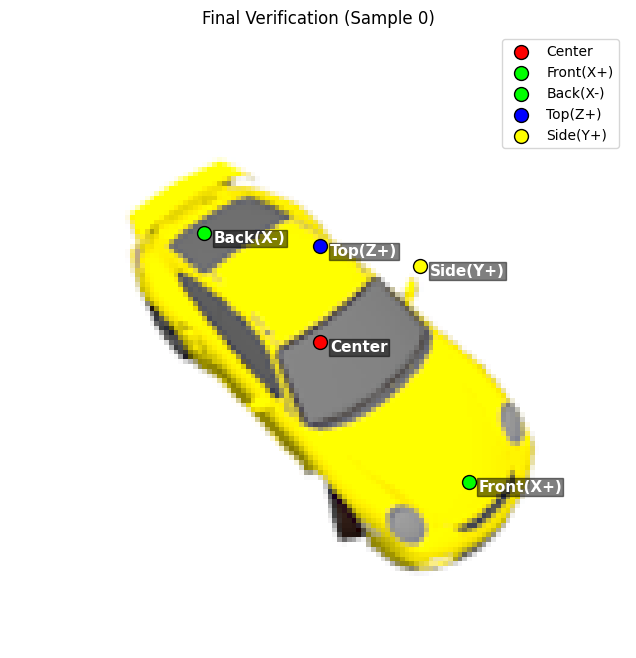

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import os
from config.config import Config
from data.shapenet import FilteredShapeNetDataset
from utils.geometry import ProjectionUtils

# 1. 설정 및 데이터셋 로드
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Config 파일이 없다면 기본값 사용, 있다면 경로 지정
if os.path.exists("config/default_config.yaml"):
    config = Config.from_yaml("config/default_config.yaml")
else:
    # 기본 Config 객체 생성 (필요한 값만 채움)
    from config.config import DataConfig, ModelConfig, TrainingConfig, OptimizerConfig, SchedulerConfig
    data_cfg = DataConfig(data_root="/content/pixNeRF_shapeNet_v2_data") # 경로 확인 필요!
    config = Config(data=data_cfg, model=ModelConfig(), training=TrainingConfig(), optimizer=OptimizerConfig(), scheduler=SchedulerConfig())

# 데이터셋 초기화 (여기서 shapenet.py의 __getitem__ 로직이 사용됨)
dataset = FilteredShapeNetDataset(
    data_root=config.data.data_root,
    split='val',
    num_source_views=config.data.num_source_views,
    image_size=config.data.image_size,
    use_imagenet_normalize=config.data.use_imagenet_normalize
)

print("Dataset loaded using UPDATED shapenet.py")

def verify_shapenet_alignment(sample_idx=0):
    # 2. 데이터셋에서 샘플 하나 가져오기 (이미 회전이 적용된 상태여야 함)
    data = dataset[sample_idx]

    src_images = data['src_images'].unsqueeze(0).to(device)
    src_poses = data['src_poses'].unsqueeze(0).to(device) # 이미 회전된 포즈
    src_intrinsics = data['src_intrinsics'].unsqueeze(0).to(device)

    H, W = config.data.image_size

    # 3. 3D 뼈대 포인트 (가설: X=Front, Z=Up)
    points_world = torch.tensor([
        [0.0, 0.0, 0.0],   # Center (Red)
        [0.4, 0.0, 0.0],   # Front (Green) -> 앞범퍼여야 함
        [-0.4, 0.0, 0.0],  # Back (Green)
        [0.0, 0.0, 0.3],   # Top (Blue) -> 지붕이어야 함
        [0.0, 0.3, 0.0],   # Side (Yellow) -> 옆문이어야 함
    ], dtype=torch.float32, device=device)

    labels = ['Center', 'Front(X+)', 'Back(X-)', 'Top(Z+)', 'Side(Y+)']
    colors = ['red', 'lime', 'lime', 'blue', 'yellow']

    view_idx = 0
    img_tensor = src_images[0, view_idx].cpu()

    # 이미지 복원
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
    img_vis = (img_tensor * std + mean).clamp(0, 1).permute(1, 2, 0).numpy()

    # 4. 투영 (Dataset이 준 포즈를 그대로 사용)
    points_2d, valid = ProjectionUtils.project_points(
        points_world,
        src_intrinsics[0, view_idx],
        src_poses[0, view_idx],
        (H, W)
    )

    points_2d = points_2d.cpu().numpy()
    valid = valid.cpu().numpy()

    # 5. 시각화
    plt.figure(figsize=(8, 8))
    plt.imshow(img_vis)
    plt.title(f"Final Verification (Sample {sample_idx})")

    for i in range(len(points_world)):
        if valid[i]:
            x, y = points_2d[i]
            plt.scatter(x, y, c=colors[i], s=100, edgecolors='black', label=labels[i])
            plt.text(x+2, y+2, labels[i], color='white', fontsize=11, fontweight='bold',
                     bbox=dict(facecolor='black', alpha=0.5, pad=1))
        else:
            print(f"⚠️ Point '{labels[i]}' is out of view.")

    plt.legend(loc='upper right')
    plt.axis('off')
    plt.show()

# 실행
print("▼▼▼ shapenet.py 내부 로직 검증 ▼▼▼")
verify_shapenet_alignment(sample_idx=0)

Loaded 352 instances for val split

🚀 Loading cached pairs from ./cache/pairs_val_a10-45_d1.0-2.0_n352.pt
  Loaded 6,390,912 pairs from cache.


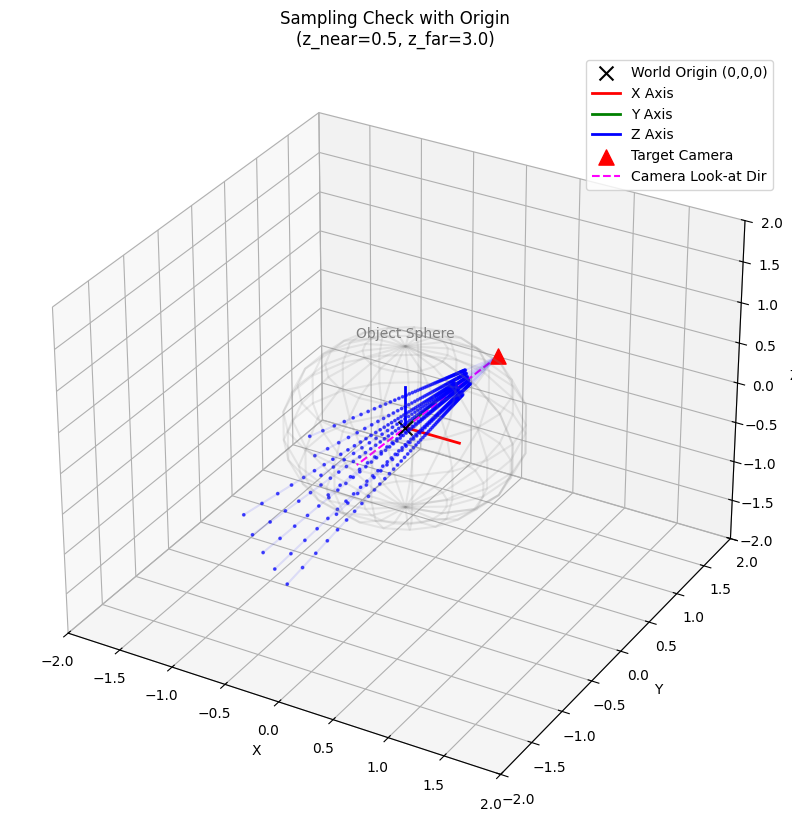

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import os
import sys

# 프로젝트 루트 경로 설정
sys.path.append(os.getcwd())

# =========================================================
# 1. 모듈 Import
# =========================================================
from config.config import Config
from data.shapenet import FilteredShapeNetDataset
from utils.rendering import VolumeRenderer
from utils.geometry import CameraUtils

# =========================================================
# 2. Config 및 데이터셋 로드
# =========================================================
config_path = "config/default_config.yaml"

if os.path.exists(config_path):
    config = Config.from_yaml(config_path)
else:
    # Config 파일이 없으면 기본값 사용
    from config.config import DataConfig, ModelConfig, TrainingConfig, OptimizerConfig, SchedulerConfig
    data_cfg = DataConfig(data_root="/content/pixNeRF_shapeNet_v2_data")
    config = Config(data=data_cfg, model=ModelConfig(), training=TrainingConfig(), optimizer=OptimizerConfig(), scheduler=SchedulerConfig())

# 데이터셋 초기화
dataset = FilteredShapeNetDataset(
    data_root=config.data.data_root,
    split='val',
    num_source_views=config.data.num_source_views,
    image_size=config.data.image_size,
    use_imagenet_normalize=config.data.use_imagenet_normalize
)

# 데이터 샘플 1개 가져오기
data = dataset[0]

# =========================================================
# 3. 데이터 추출 (올바른 Key 사용)
# =========================================================
src_poses = data['src_poses']          # (V, 4, 4)
tgt_pose = data['tgt_pose']             # (4, 4)
tgt_intrinsics = data['tgt_intrinsics'] # (3, 3)

# 텐서 변환
if not torch.is_tensor(tgt_pose): tgt_pose = torch.from_numpy(tgt_pose)
if not torch.is_tensor(tgt_intrinsics): tgt_intrinsics = torch.from_numpy(tgt_intrinsics)

# =========================================================
# 4. 광선(Rays) 생성
# =========================================================
H, W = config.data.image_size
rays_o_full, rays_d_full = CameraUtils.get_rays(H, W, tgt_intrinsics, tgt_pose)

# Flatten
rays_o = rays_o_full.reshape(-1, 3)
rays_d = rays_d_full.reshape(-1, 3)

# =========================================================
# 5. 시각화 대상 선택 및 샘플링
# =========================================================
# 센터 부근의 광선을 보기 위해 인덱스 조정 (이미지 중심부)
mid_idx = rays_o.shape[0] // 2
# 중심부 주변에서 10개 추출
viz_indices = np.linspace(mid_idx - 2000, mid_idx + 2000, 10, dtype=int)
# 혹은 전체 균등 추출 (원하는 대로 주석 해제)
# viz_indices = np.linspace(0, rays_o.shape[0]-1, 10, dtype=int)

selected_rays_o = rays_o[viz_indices]
selected_rays_d = rays_d[viz_indices]

# Renderer 초기화
renderer = VolumeRenderer(
    white_bkgd=config.model.white_bkgd,
    noise_std=0.0
)

# 실제 샘플링 수행
points, z_vals = renderer.sample_along_rays(
    rays_o=selected_rays_o,
    rays_d=selected_rays_d,
    z_near=config.data.z_near,
    z_far=config.data.z_far,
    n_samples=config.model.n_coarse, # 수정된 rendering.py가 반영되면 균등 간격이어야 함
    perturb=False
)

# =========================================================
# 6. 3D 시각화 (원점 및 축 추가)
# =========================================================
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection='3d')

# (1) [핵심] 월드 원점 (0,0,0) 및 축 표시
ax.scatter(0, 0, 0, c='black', marker='x', s=100, label='World Origin (0,0,0)', zorder=10)

# X축 (Red), Y축 (Green), Z축 (Blue) - 길이 0.5
ax.plot([0, 0.5], [0, 0], [0, 0], c='r', linewidth=2, label='X Axis')
ax.plot([0, 0], [0, 0.5], [0, 0], c='g', linewidth=2, label='Y Axis')
ax.plot([0, 0], [0, 0], [0, 0.5], c='b', linewidth=2, label='Z Axis')

# (2) Unit Sphere (Object Zone) - 원점 기준 반지름 1.0
u, v = np.mgrid[0:2*np.pi:20j, 0:np.pi:10j]
x_sphere = np.cos(u)*np.sin(v)
y_sphere = np.sin(u)*np.sin(v)
z_sphere = np.cos(v)
ax.plot_wireframe(x_sphere, y_sphere, z_sphere, color="grey", alpha=0.15)
ax.text(0, 0, 1.1, "Object Sphere", color='grey', ha='center')

# (3) Target View Camera (Red)
tgt_cam_pos = selected_rays_o[0].numpy()
ax.scatter(tgt_cam_pos[0], tgt_cam_pos[1], tgt_cam_pos[2],
           c='red', marker='^', s=120, label='Target Camera', zorder=5)

# [추가] 카메라가 바라보는 방향 (Optical Axis)
# 포즈 행렬의 3번째 컬럼(Z축)이 보통 바라보는 방향(OpenCV: +Z)
forward_dir = tgt_pose[:3, 2].numpy() # rotation * [0,0,1]
look_at_end = tgt_cam_pos + forward_dir * 2.0 # 2.0 미터 앞까지 선 그리기
ax.plot([tgt_cam_pos[0], look_at_end[0]],
        [tgt_cam_pos[1], look_at_end[1]],
        [tgt_cam_pos[2], look_at_end[2]],
        c='magenta', linestyle='--', label='Camera Look-at Dir')

# (4) Rays & Samples (Blue)
points_np = points.detach().cpu().numpy()
rays_o_np = selected_rays_o.detach().cpu().numpy()

for i in range(len(points_np)):
    pts = points_np[i]
    # 샘플 점
    ax.scatter(pts[:, 0], pts[:, 1], pts[:, 2], c='blue', s=3, alpha=0.6)
    # 광선
    ax.plot([rays_o_np[i, 0], pts[-1, 0]],
            [rays_o_np[i, 1], pts[-1, 1]],
            [rays_o_np[i, 2], pts[-1, 2]],
            c='blue', alpha=0.1)

# 설정
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title(f"Sampling Check with Origin\n(z_near={config.data.z_near}, z_far={config.data.z_far})")
# 스케일 고정 (왜곡 방지)
limit = 2.0
ax.set_xlim([-limit, limit])
ax.set_ylim([-limit, limit])
ax.set_zlim([-limit, limit])
ax.legend()

plt.show()

Loaded 352 instances for val split

🚀 Loading cached pairs from ./cache/pairs_val_a10-45_d1.0-2.0_n352.pt
  Loaded 6,390,912 pairs from cache.


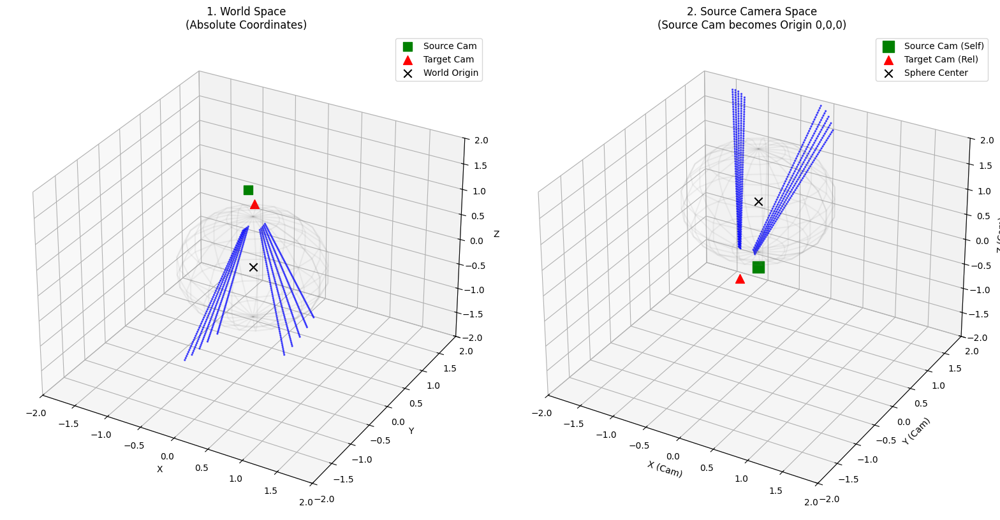

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import os
import sys

# 프로젝트 루트 경로
sys.path.append(os.getcwd())

from config.config import Config
from data.shapenet import FilteredShapeNetDataset
from utils.rendering import VolumeRenderer
from utils.geometry import CameraUtils

# =========================================================
# 1. 설정 및 데이터 로드
# =========================================================
config_path = "config/default_config.yaml"
if os.path.exists(config_path):
    config = Config.from_yaml(config_path)
else:
    # Fallback
    from config.config import DataConfig, ModelConfig, TrainingConfig, OptimizerConfig, SchedulerConfig
    data_cfg = DataConfig(data_root="/content/pixNeRF_shapeNet_v2_data")
    config = Config(data=data_cfg, model=ModelConfig(), training=TrainingConfig(), optimizer=OptimizerConfig(), scheduler=SchedulerConfig())

# Validation 셋 로드
dataset = FilteredShapeNetDataset(
    data_root=config.data.data_root,
    split='val',
    num_source_views=config.data.num_source_views,
    image_size=config.data.image_size,
    use_imagenet_normalize=config.data.use_imagenet_normalize
)

data = dataset[0]

# =========================================================
# 2. 데이터 추출
# =========================================================
# Source Poses (V, 4, 4) - 첫 번째 소스 뷰만 사용해서 검증
src_poses = data['src_poses']
if not torch.is_tensor(src_poses): src_poses = torch.from_numpy(src_poses)
src_pose_0 = src_poses[0] # (4, 4) 첫번째 소스 뷰

# Target Info
tgt_pose = data['tgt_pose']
tgt_intrinsics = data['tgt_intrinsics']
if not torch.is_tensor(tgt_pose): tgt_pose = torch.from_numpy(tgt_pose)
if not torch.is_tensor(tgt_intrinsics): tgt_intrinsics = torch.from_numpy(tgt_intrinsics)

# =========================================================
# 3. 월드 좌표계에서 샘플링 (World Space Sampling)
# =========================================================
H, W = config.data.image_size
rays_o_full, rays_d_full = CameraUtils.get_rays(H, W, tgt_intrinsics, tgt_pose)
rays_o = rays_o_full.reshape(-1, 3)
rays_d = rays_d_full.reshape(-1, 3)

# 시각화용 레이 선택 (중심부 10개)
mid_idx = rays_o.shape[0] // 2
viz_indices = np.linspace(mid_idx - 2000, mid_idx + 2000, 10, dtype=int)
selected_rays_o = rays_o[viz_indices]
selected_rays_d = rays_d[viz_indices]

# Renderer로 World Points 생성
renderer = VolumeRenderer(white_bkgd=config.model.white_bkgd, noise_std=0.0)
points_world, _ = renderer.sample_along_rays(
    rays_o=selected_rays_o, rays_d=selected_rays_d,
    z_near=config.data.z_near, z_far=config.data.z_far,
    n_samples=config.model.n_coarse, perturb=False
)
# points_world shape: (N_rays, N_samples, 3)

# =========================================================
# 4. [검증 대상] Source View 좌표계로 변환
#    (pixelnerf.py의 transform_to_camera_space 로직 재현)
# =========================================================
def transform_to_camera_space_debug(points_world, c2w):
    """
    points_world: (N, 3) or (N_rays, N_samples, 3)
    c2w: (4, 4) Source Camera Pose
    """
    # 1. World -> Camera (Inverse of Pose)
    w2c = torch.inverse(c2w) # (4, 4)

    # 2. Homogeneous Coordinates (x, y, z, 1)
    if points_world.dim() == 3: # (Rays, Samples, 3)
        N_rays, N_samples, _ = points_world.shape
        pts_flat = points_world.reshape(-1, 3)
    else:
        pts_flat = points_world

    ones = torch.ones(pts_flat.shape[0], 1, device=pts_flat.device)
    pts_h = torch.cat([pts_flat, ones], dim=1) # (N_total, 4)

    # 3. Matrix Multiplication: (W2C @ P^T)^T
    # pts_cam_h = (w2c @ pts_h.T).T
    # 혹은 P @ W2C^T (pytorch 스타일)
    pts_cam_h = torch.matmul(pts_h, w2c.T)

    pts_cam = pts_cam_h[:, :3]

    if points_world.dim() == 3:
        return pts_cam.reshape(N_rays, N_samples, 3)
    return pts_cam

# 변환 실행
points_cam = transform_to_camera_space_debug(points_world, src_pose_0)

# (참고용) 월드 원점(0,0,0)과 타겟 카메라도 소스 뷰 기준으로 어디 있는지 변환
world_origin = torch.tensor([[0., 0., 0.]])
tgt_cam_origin = tgt_pose[:3, 3].unsqueeze(0)

origin_in_src = transform_to_camera_space_debug(world_origin, src_pose_0)
tgt_cam_in_src = transform_to_camera_space_debug(tgt_cam_origin, src_pose_0)

# =========================================================
# 5. 시각화 (좌: World / 우: Source Camera View)
# =========================================================
fig = plt.figure(figsize=(16, 8))

# ---------------------------------------------------------
# Plot 1: World Space
# ---------------------------------------------------------
ax1 = fig.add_subplot(121, projection='3d')
ax1.set_title("1. World Space\n(Absolute Coordinates)")

# Source Cam (Green Square)
src_pos = src_pose_0[:3, 3].numpy()
ax1.scatter(src_pos[0], src_pos[1], src_pos[2], c='green', marker='s', s=100, label='Source Cam')

# Target Cam (Red Triangle)
tgt_pos = tgt_pose[:3, 3].numpy()
ax1.scatter(tgt_pos[0], tgt_pos[1], tgt_pos[2], c='red', marker='^', s=100, label='Target Cam')

# World Origin (Black X)
ax1.scatter(0, 0, 0, c='black', marker='x', s=80, label='World Origin')
# Object Sphere
u, v = np.mgrid[0:2*np.pi:20j, 0:np.pi:10j]
ax1.plot_wireframe(np.cos(u)*np.sin(v), np.sin(u)*np.sin(v), np.cos(v), color="grey", alpha=0.1)

# Sample Points (Blue)
pts_w_np = points_world.numpy()
for i in range(len(pts_w_np)):
    ax1.plot(pts_w_np[i, :, 0], pts_w_np[i, :, 1], pts_w_np[i, :, 2], c='blue', alpha=0.3)
    ax1.scatter(pts_w_np[i, :, 0], pts_w_np[i, :, 1], pts_w_np[i, :, 2], c='blue', s=2, alpha=0.5)

ax1.set_xlabel('X'); ax1.set_ylabel('Y'); ax1.set_zlabel('Z')
ax1.legend()
ax1.set_xlim(-2, 2); ax1.set_ylim(-2, 2); ax1.set_zlim(-2, 2)


# ---------------------------------------------------------
# Plot 2: Source Camera Space
# ---------------------------------------------------------
ax2 = fig.add_subplot(122, projection='3d')
ax2.set_title("2. Source Camera Space\n(Source Cam becomes Origin 0,0,0)")

# Source Cam IS Origin (Green Square)
ax2.scatter(0, 0, 0, c='green', marker='s', s=150, label='Source Cam (Self)', zorder=10)

# Target Cam relative position (Red Triangle)
tgt_in_src_np = tgt_cam_in_src.numpy()[0]
ax2.scatter(tgt_in_src_np[0], tgt_in_src_np[1], tgt_in_src_np[2], c='red', marker='^', s=100, label='Target Cam (Rel)')

# World Origin relative position (Black X) -> Sphere Center
origin_in_src_np = origin_in_src.numpy()[0]
ax2.scatter(origin_in_src_np[0], origin_in_src_np[1], origin_in_src_np[2], c='black', marker='x', s=80, label='Sphere Center')

# Transformed Sample Points (Blue)
pts_c_np = points_cam.numpy()
for i in range(len(pts_c_np)):
    ax2.plot(pts_c_np[i, :, 0], pts_c_np[i, :, 1], pts_c_np[i, :, 2], c='blue', alpha=0.3)
    ax2.scatter(pts_c_np[i, :, 0], pts_c_np[i, :, 1], pts_c_np[i, :, 2], c='blue', s=2, alpha=0.5)

# Transformed Sphere (Visual Aid) - Sphere center moved to origin_in_src
# Sphere also needs to be rotated strictly speaking, but for sphere shape doesn't matter, just position
sx, sy, sz = origin_in_src_np
ax2.plot_wireframe(np.cos(u)*np.sin(v)+sx, np.sin(u)*np.sin(v)+sy, np.cos(v)+sz, color="grey", alpha=0.1)

ax2.set_xlabel('X (Cam)'); ax2.set_ylabel('Y (Cam)'); ax2.set_zlabel('Z (Cam)')
ax2.legend()
ax2.set_xlim(-2, 2); ax2.set_ylim(-2, 2); ax2.set_zlim(-2, 2)

plt.tight_layout()
plt.show()

# Train Model

In [ ]:
!python train.py --resume checkpoints/best_model.pth

E0000 00:00:1766458197.837493    8733 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1766458197.844059    8733 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1766458197.860463    8733 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1766458197.860490    8733 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1766458197.860493    8733 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1766458197.860496    8733 computation_placer.cc:177] computation placer already registered. Please check linka

In [ ]:
%load_ext tensorboard
%tensorboard --logdir checkpoints/logs

Output hidden; open in https://colab.research.google.com to view.